### Laboratorium 5 - zadania - transformacja Hougha

In [67]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.axes import Axes
from PIL import Image

#### Zadanie 1

Zbadaj wpływ parametrów transformacji Hougha na jakość detekcji prostych na przykładzie obrazu `norway`. Wykorzystaj ulubiony detektor krawędzi i zaprezentuj wyniki pośrednie przed użyciem transformacji Hougha. Zapoznaj się z dokumentacją funkcji [`cv2.HoughLines`](https://docs.opencv.org/4.5.3/dd/d1a/group__imgproc__feature.html#ga46b4e588934f6c8dfd509cc6e0e4545a), zwłaszcza parametrami sterującymi rozdzielczością `rho`, `theta` oraz progiem `threshold`.

Zacznij od znalezienia odpowiednich parametrów detektora krawędzi - jeśli na tym etapie wyniki będą słabe, to dalej będzie tylko gorzej (_garbage-in, garbage-out_) - ale nie skupiaj się na badaniu ich wpływu na wyniki.

Ostateczny rezultat zaprezentuj w postaci odcinków naniesionych na kopię obrazu wejściowego (patrz komórka `[3]`).

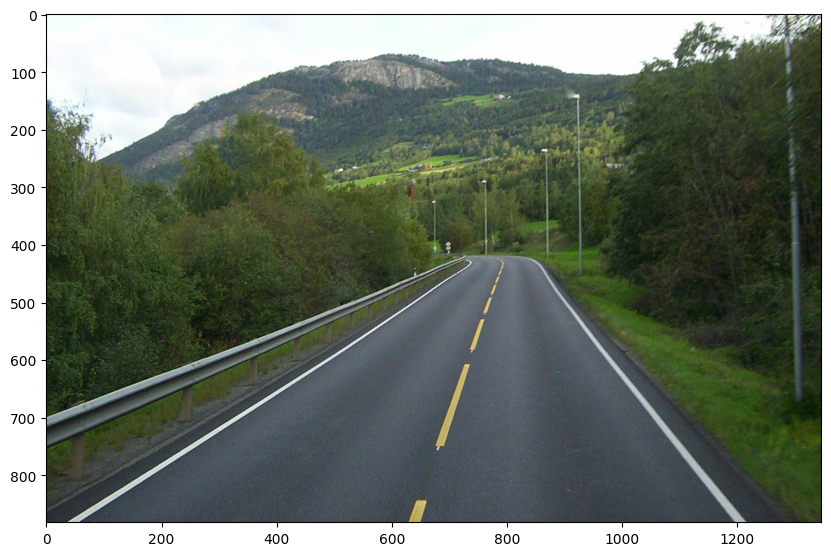

In [2]:
norway = cv2.imread('norway.jpg')
plt.subplots(1, 1, figsize=(10,10))[1].imshow(norway[..., ::-1]);

In [3]:
def rhotheta2xy(line):
    # konwersja parametrów prostej w układzie rho-theta do odcinka w układzie kartezjańskim
    # wynik można użyć jako argumenty funkcji cv2.line
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a * rho
    y0 = b * rho
    x1 = int(x0 + 5000 * (-b))
    y1 = int(y0 + 5000 * a)
    x2 = int(x0 - 5000 * (-b))
    y2 = int(y0 - 5000 * a)
    return x1, y1, x2, y2

In [92]:
def blur(src: np.ndarray) -> np.ndarray:
    return cv2.GaussianBlur(src, (5, 5), 0)

def canny(src: np.ndarray, th1: int, th2: int) -> np.ndarray:
    return cv2.Canny(src, th1, th2)

def draw_hough_lines(src: np.ndarray, rho: float, theta: float, threshold: int, canny_th1=50, canny_th2=180):
    image = cv2.cvtColor(src.copy(), cv2.COLOR_RGB2GRAY)
    image = blur(image)
    image = canny(image, canny_th1, canny_th2)
    lines = cv2.HoughLines(image, rho, theta, threshold)
    if lines is None or len(lines) == 0:
        return None
    img_with_lines = src.copy()
    for line in lines:
        x1, y1, x2, y2 = rhotheta2xy(line) 
        img_with_lines = cv2.line(img_with_lines, (x1, y1), (x2, y2), (255, 0, 255), 2)
    return img_with_lines

def make_gif(images: list[Image.Image], path: str, duration=200):
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=duration,
        loop=0
    )

### Znalezienie najlepszej reprezentacji Cannego

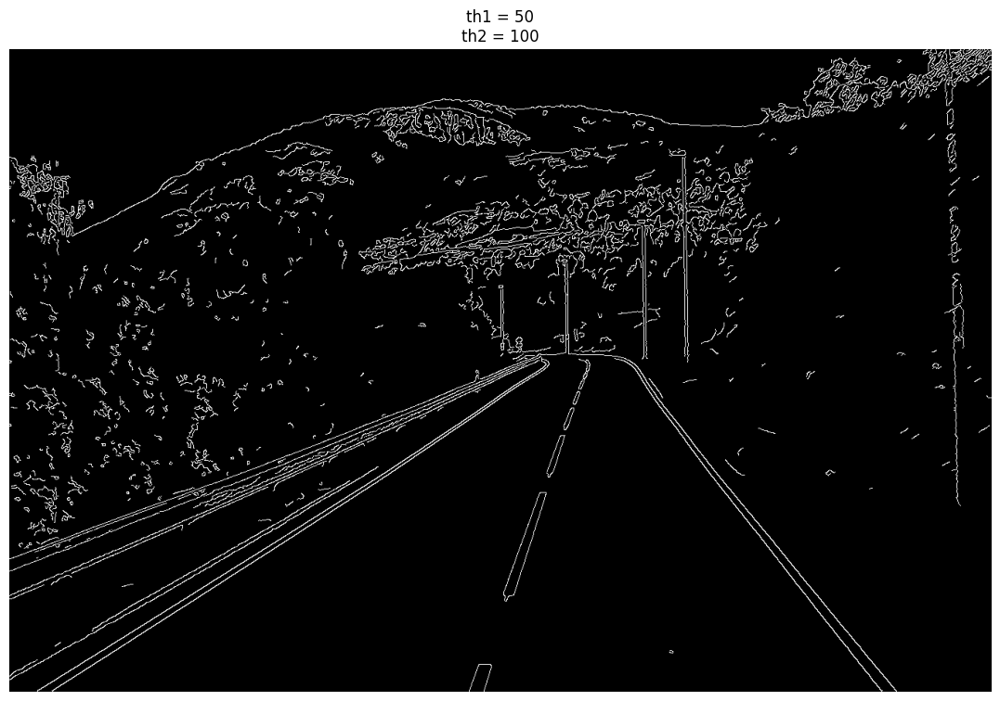

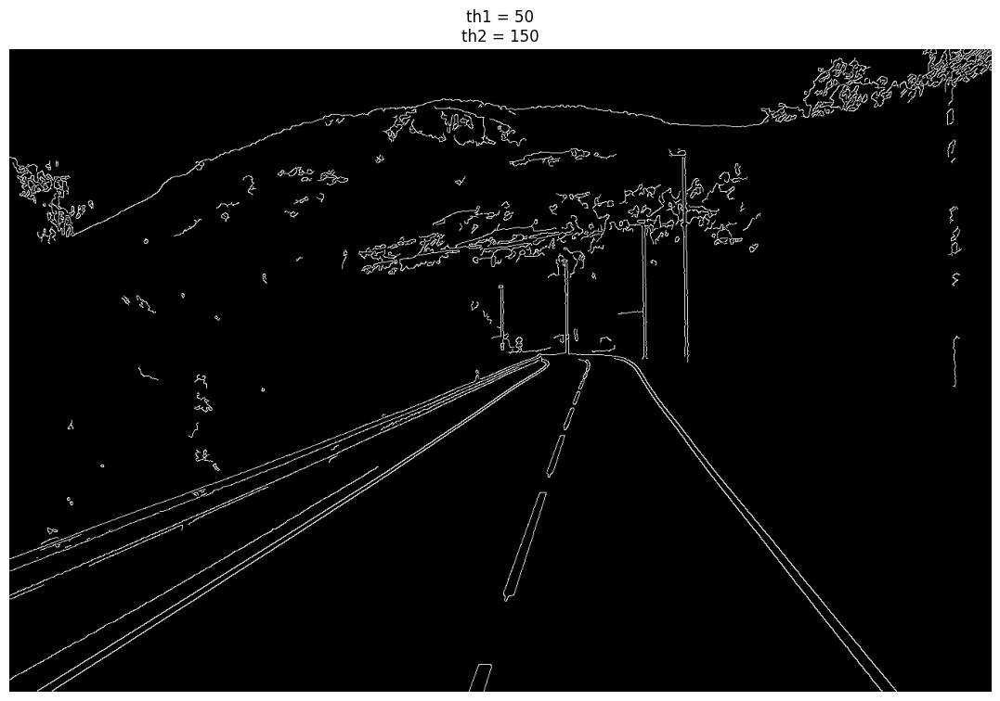

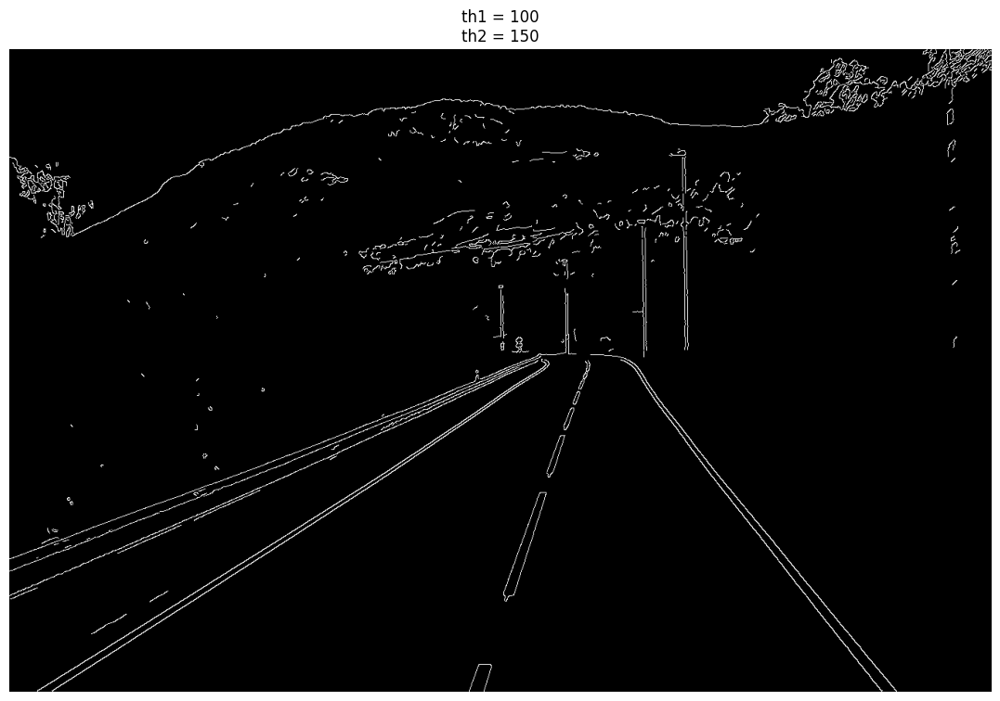

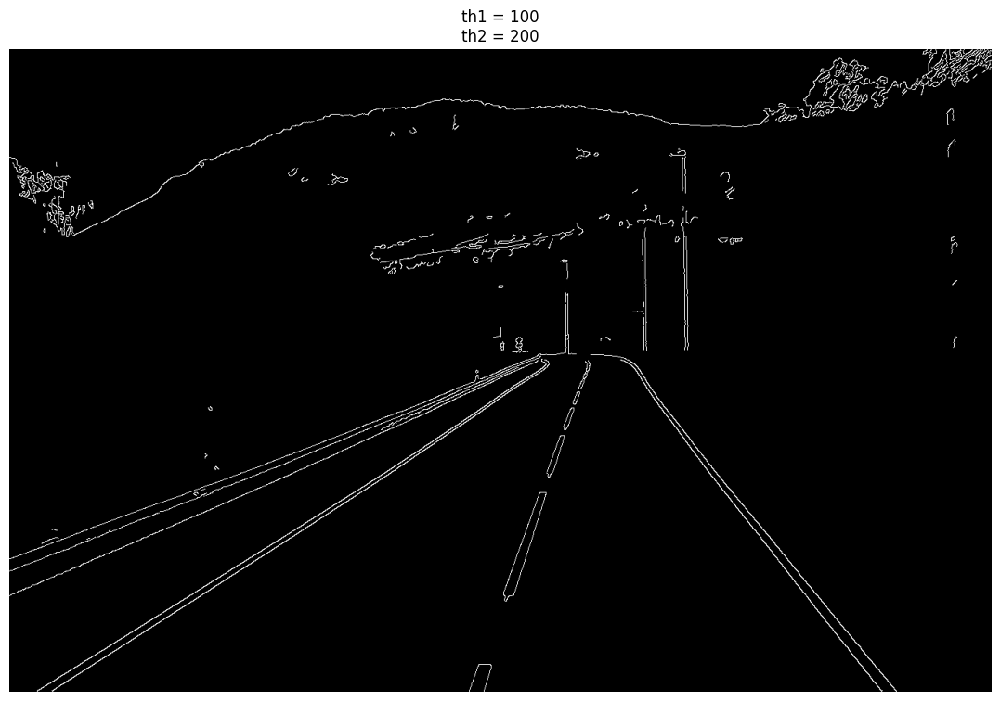

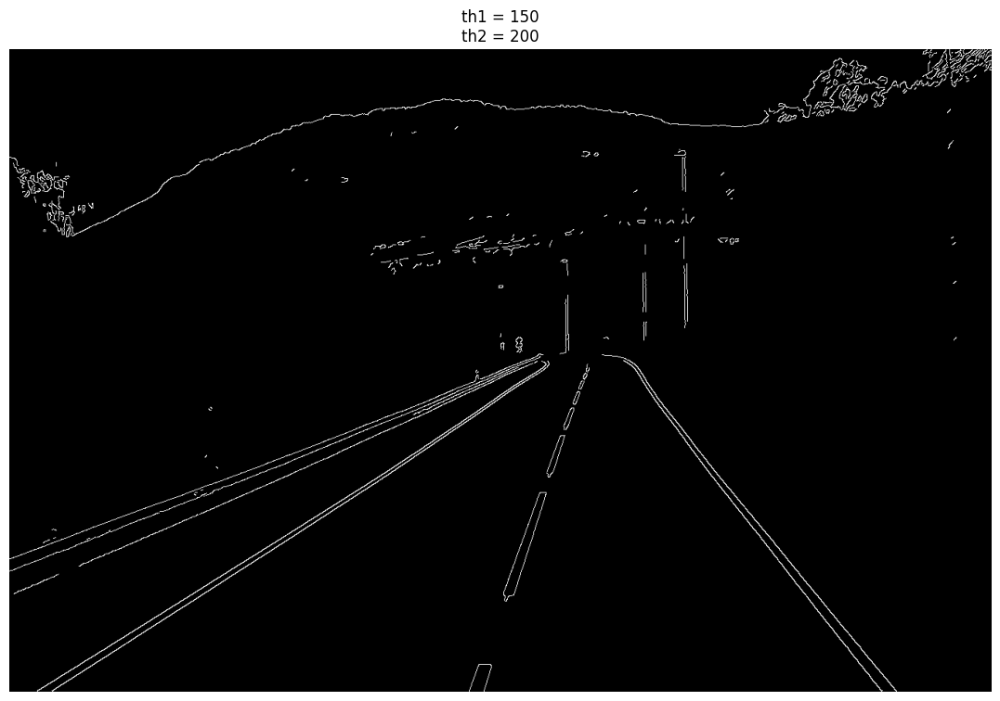

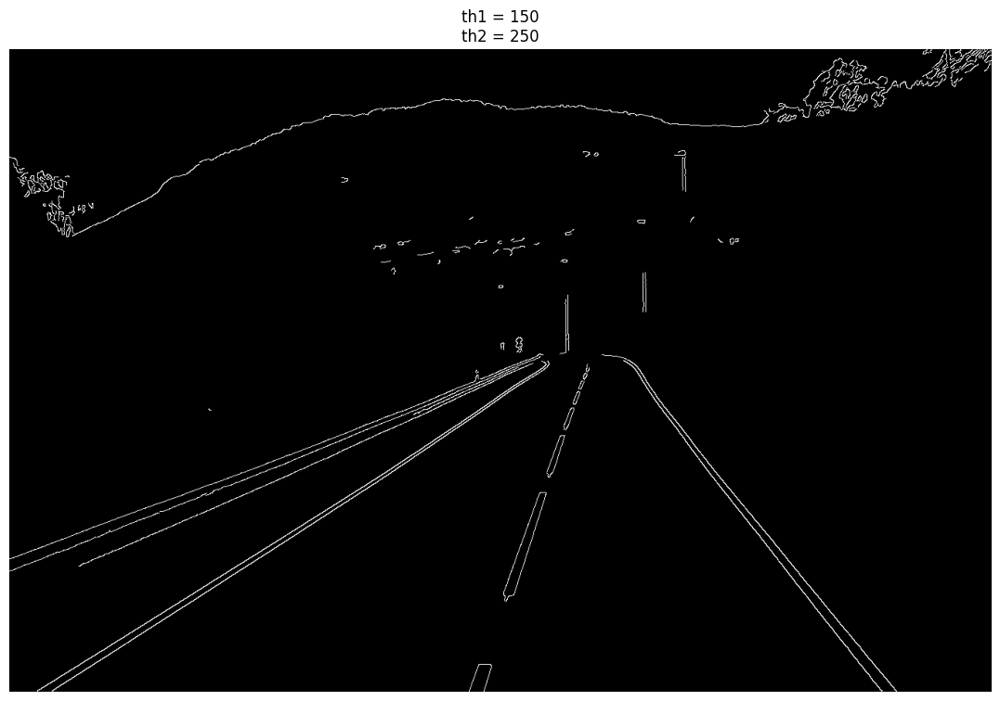

In [90]:
image = cv2.cvtColor(cv2.imread('norway.jpg'), cv2.COLOR_BGR2GRAY)
canny_th = [(50, 100), (50, 150), (100, 150), (100, 200), (150, 200), (150, 250)]
images = []
for (th1, th2) in canny_th:
    fig, ax = plt.subplots(1, 1, figsize=(16, 9))
    canny_img = canny(blur(image), th1, th2)
    images.append(Image.fromarray(canny_img))
    ax.imshow(canny_img, cmap='gray')
    ax.axis('off')
    ax.set_title(f'{th1 = }\n{th2 = }')

make_gif(images, 'canny.gif')

Rozwiązanie:

In [94]:
rho = 1
thetas = [np.pi, np.pi / 4, np.pi / 16, np.pi / 64, np.pi / 180]
images = []
for theta in thetas:
    orig = cv2.cvtColor(cv2.imread('norway.jpg'), cv2.COLOR_BGR2RGB)
    hough = draw_hough_lines(orig, rho, theta, threshold=100, canny_th1=150, canny_th2=250)
    if hough is None:
        continue
    images.append(Image.fromarray(hough))
make_gif(images, 'theta.gif', duration=500)

In [ ]:
rhos = [0.1, 0.5, 1, 1.5, 3, 10]
theta = np.pi / 64
images = []
for rho in rhos:
    orig = cv2.cvtColor(cv2.imread('norway.jpg'), cv2.COLOR_BGR2RGB)
    hough = draw_hough_lines(orig, rho, theta, threshold=100, canny_th1=150, canny_th2=250)
    if hough is None:
        continue
    images.append(Image.fromarray(hough))
make_gif(images, 'rho.gif', duration=500)

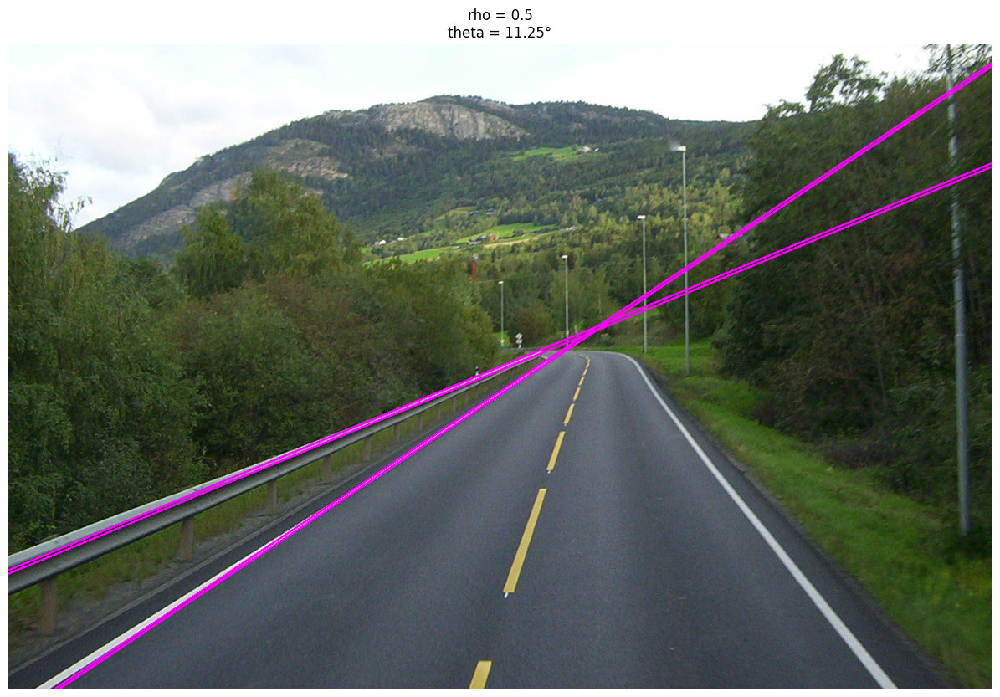

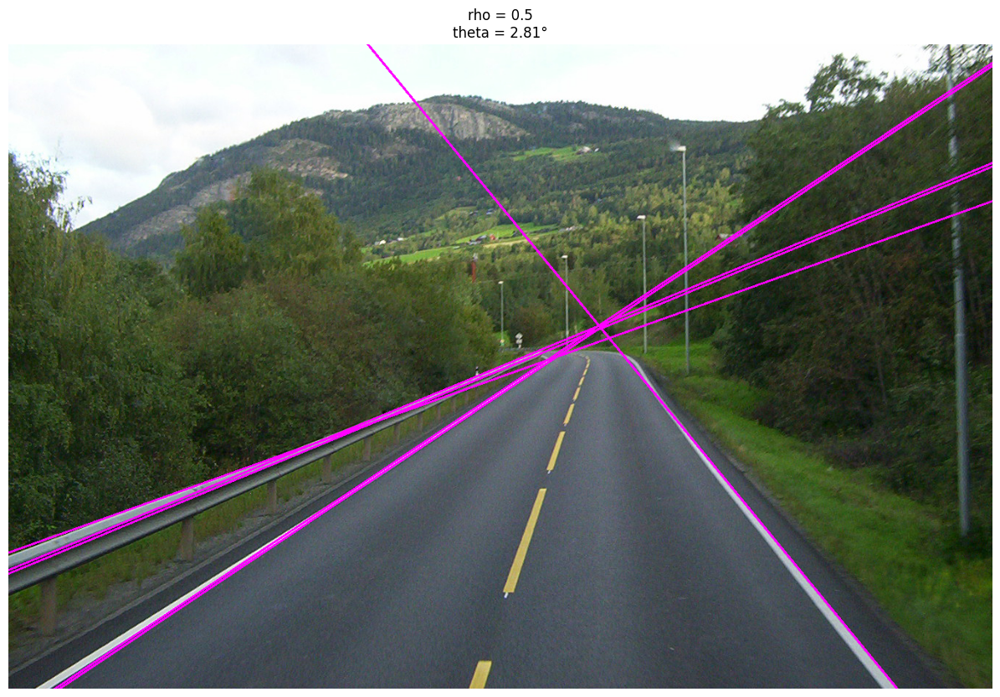

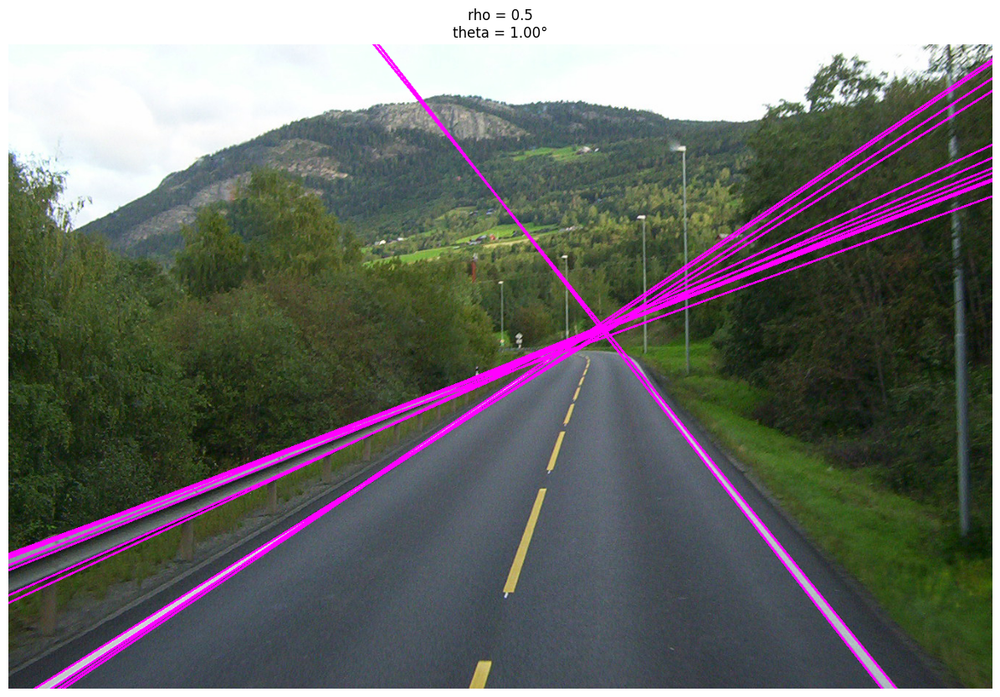

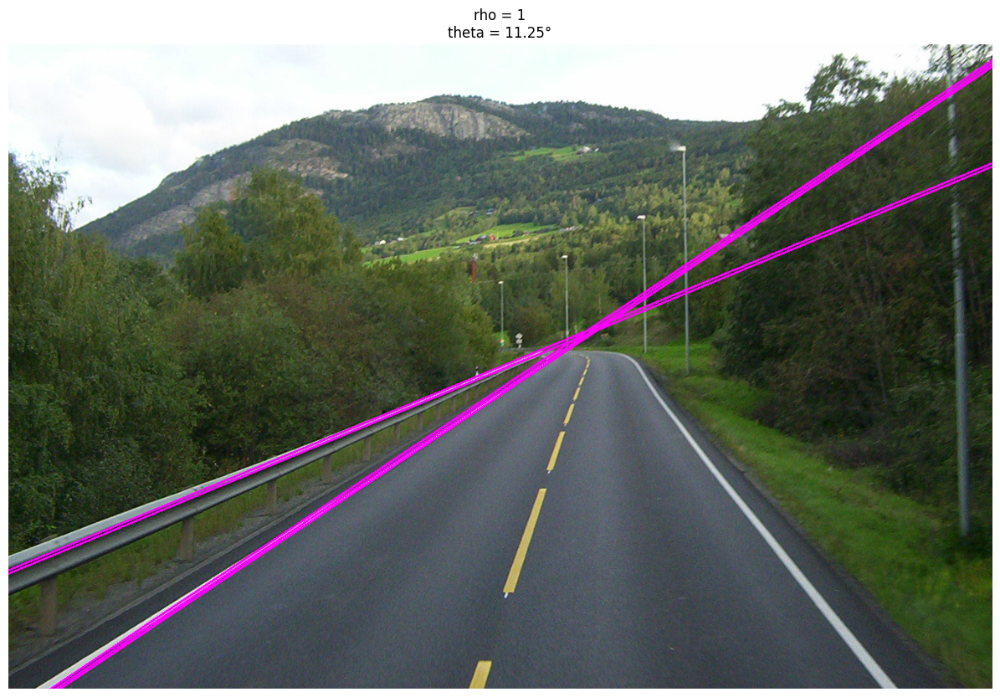

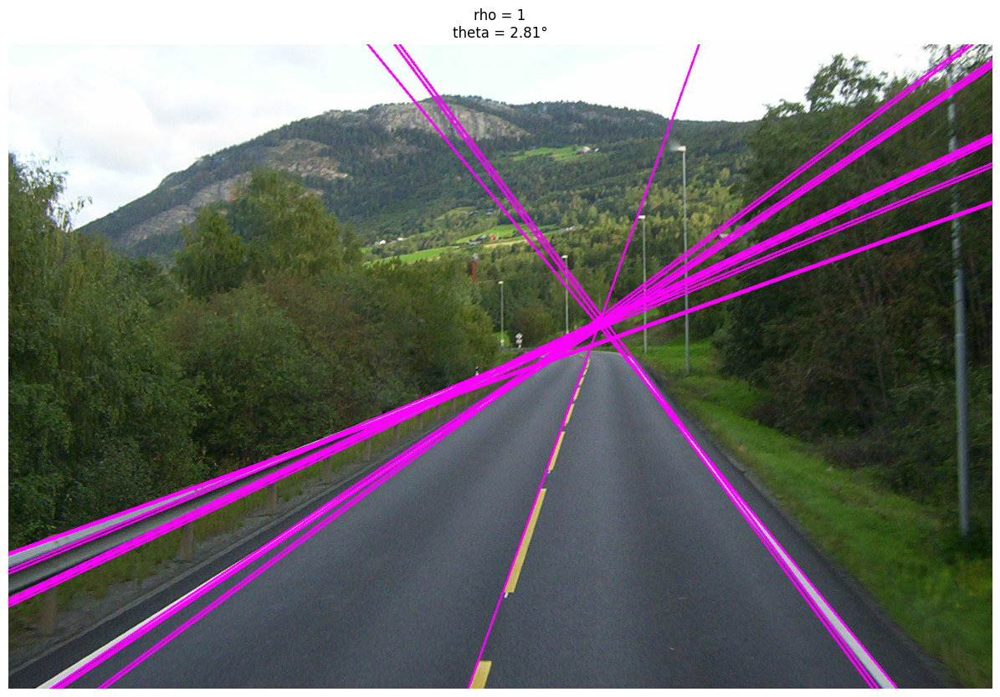

...

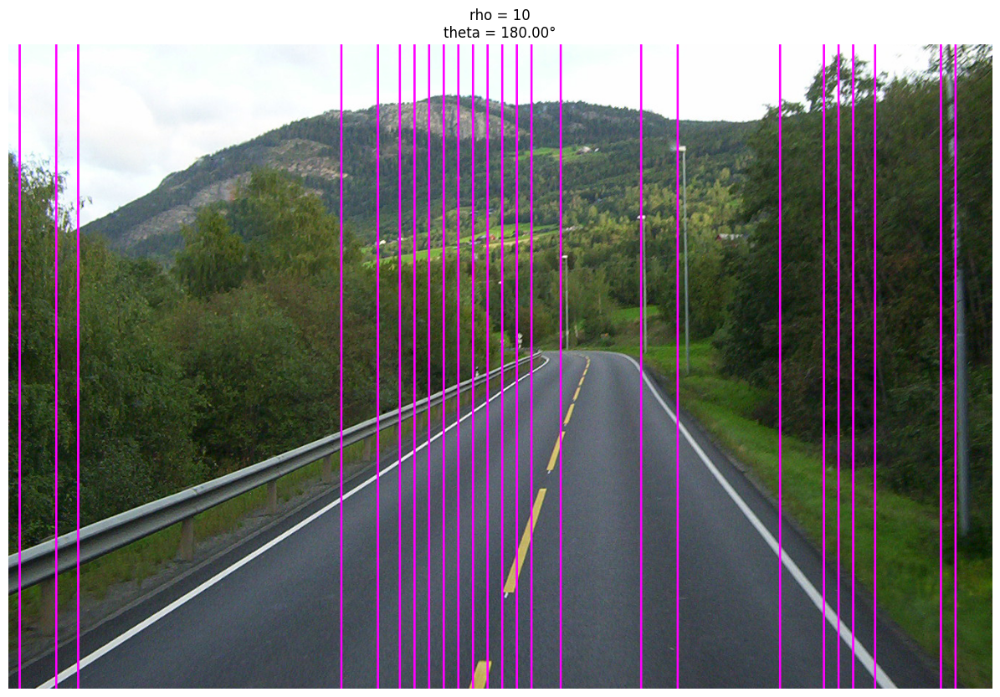

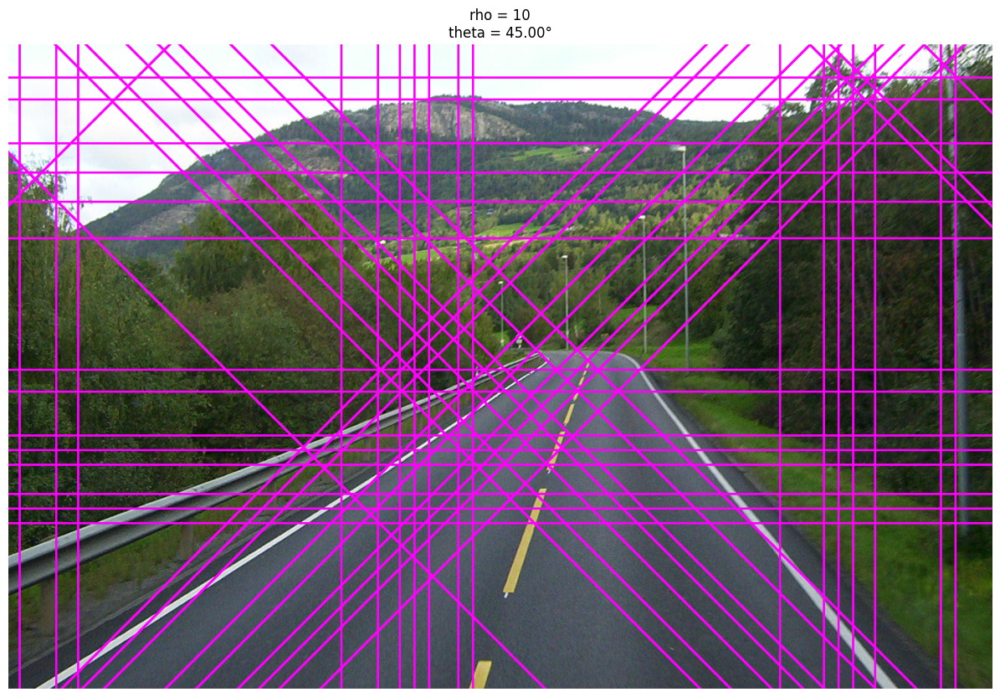

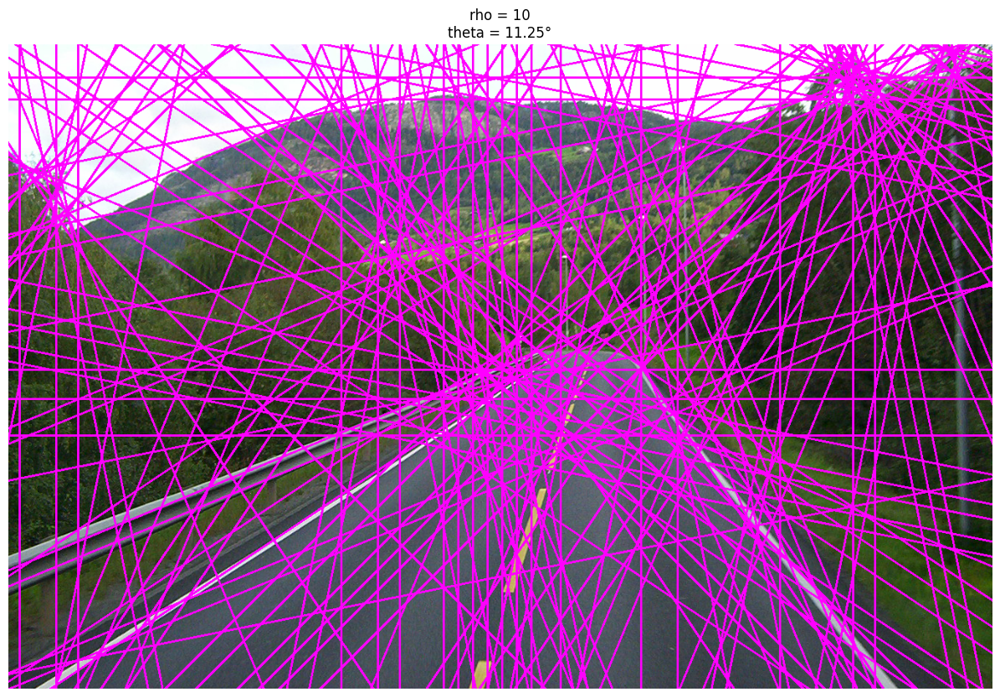

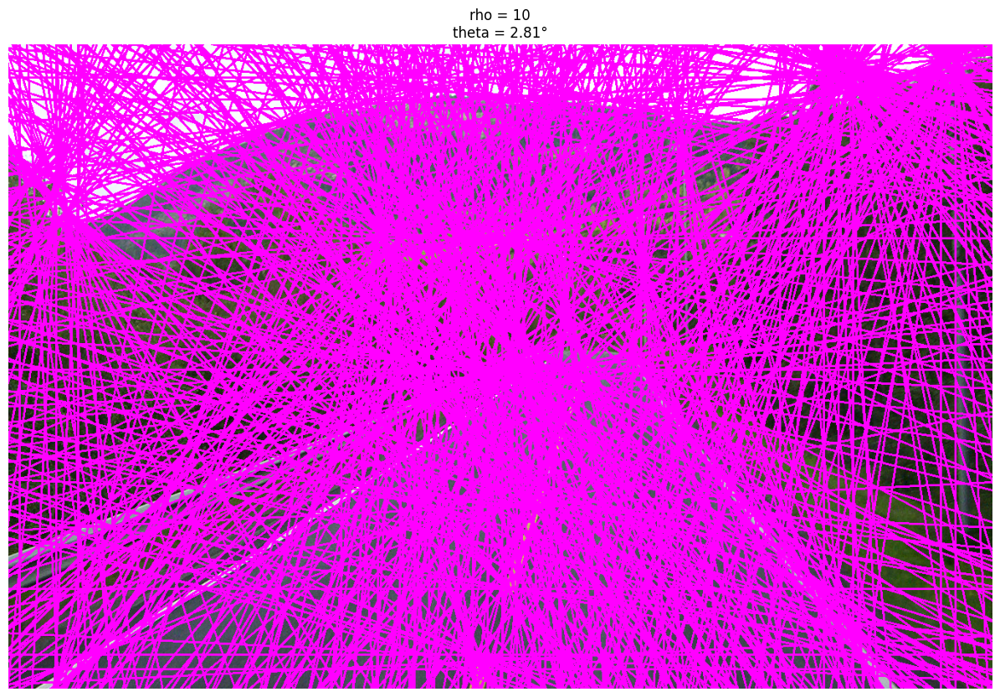

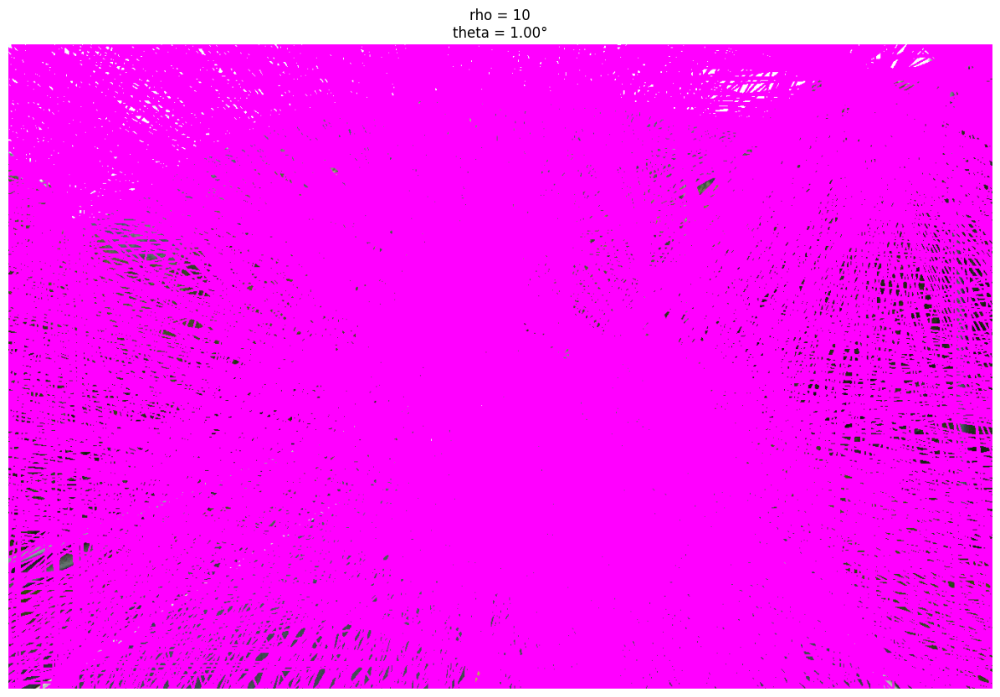

In [88]:
rhos = [0.1, 0.5, 1, 1.5, 3, 10]
thetas = [np.pi, np.pi / 4, np.pi / 16, np.pi / 64, np.pi / 180]
for rho in rhos:
    for  theta in thetas:
        orig = cv2.cvtColor(cv2.imread('norway.jpg'), cv2.COLOR_BGR2RGB)
        hough = draw_hough_lines(orig, rho, theta, threshold=100, canny_th1=150, canny_th2=250)
        if hough is None:
            continue
        fig, ax = plt.subplots(1, 1, figsize=(20, 10))
        ax.imshow(hough, cmap='gray')
        ax.set_title(f"{rho = }\ntheta = {180 * theta / np.pi:.2f}°")
        ax.axis('off')
        plt.show()
# best rho = 1
# best theta = np.pi / 64 (2.81 stopnia)
# best canny (150, 250)

#### Zadanie 2

Dany jest obraz `pillbox`. Wykorzystaj transformację Hougha dla prostych, aby wykryć krawędzie między komórkami organizera.

Dla odmiany, w tym zadaniu nie jest istotne badanie parametrów ale wyłącznie końcowy wynik.

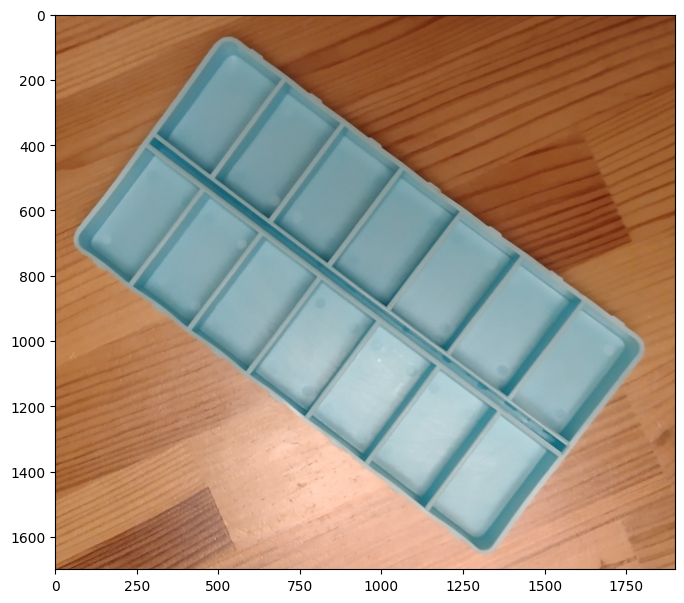

In [29]:
pillbox = cv2.imread('pillbox.png')
plt.subplots(1, 1, figsize=(8,8))[1].imshow(pillbox[..., ::-1]);

Rozwiązanie: